# Neural Network from Scratch Using Numpy

In [50]:
SEED = 8 

In [51]:
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split
%matplotlib inline

In this project, I implement a neural network class from scratch using numpy only. I also implement the following functions:

1. *Forward/backward pass & Weight Update:* I implement the forward and backward pass algorithms and avoid any for loop, i.e., use vectorization only.

2. *Optimizers:* I implement full-batch Gradient Descent, Minibatch and Stochastic gradient descent variants.

3. For weights I use standard normal distribution (0 mean and 1 var). Biases are initialized to all zero.

4. **Visualization code**: I also provide a visualization code to plot the learnt decision boundary of my model.

5. *Activation Functions:* I also implement the following activation functions :
- Sigmoid
- ReLU
- Leaky ReLU (leaky slope is fixed at 0.05)


In [52]:
# Helper function to plot a decision boundary.

def plot_decision_boundary(pred_func, x_min, x_max, y_min, y_max, cmap, ax):
    h = 0.01
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    Z = pred_func(np.c_[xx.flatten(), yy.flatten()])
    Z = Z.reshape(xx.shape)
    ax.contourf(xx, yy, Z, cmap=cmap, alpha=0.5)

In [53]:
from keras.utils import to_categorical
class NeuralNetwork():
    @staticmethod
    def cross_entropy_loss(y_pred, y_true):
        '''Compute cross-entropy loss'''
        '''Compute cross-entropy loss'''
        print("y_pred shape:", y_pred.shape)
        print("y_true shape:", y_true.shape)
        
        epsilon = 1e-15  

        
        if len(y_true.shape) == 1:
            y_true = to_categorical(y_true)

        y_pred = np.clip(y_pred, epsilon, 1 - epsilon)  # I have used clip to avoid the case of log(0)
        loss = -np.sum(y_true * np.log(y_pred)) / len(y_true)

        return loss
    
    @staticmethod
    def mean_squared_loss(y_pred, y_true):
        return np.mean((y_pred - y_true) ** 2)
    
    @staticmethod
    def accuracy(y_pred, y_true):
        print("y_pred shape:", y_pred.shape)
        print("y_true shape:", y_true.shape)

        if (len(y_true.shape) > 1) and (self.mode=='classification'):  
            y_true = np.argmax(y_true, axis=1)

        return np.mean(y_pred == y_true)
    
    @staticmethod
    def softmax(x):
        exp_x = np.exp(x - np.max(x, axis=-1, keepdims=True))  # Subtract max to avoid overflow
        return exp_x / np.sum(exp_x, axis=-1, keepdims=True)
    
    @staticmethod
    def sigmoid(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def ReLU(x):
        return np.maximum(0, x)

    def Leaky_ReLU(self, x):
        return np.where(x > 0, x, self.leaky_slope * x)
        

    def __init__(self, nodes_per_layer: list[int], mode: str = 'classification', optimizer: str = 'fullbatch', activation: str = 'sigmoid', batch_size: int = 64):
        '''Creates a Feed-Forward Neural Network.
        "nodes_per_layer" is a list containing the number of nodes in each layer (including the input layer) e.g. [2, 10, 10, 2] (2 features, 2 hidden layers with 10 neurons each, 2 classes)"
        '''

        if len(nodes_per_layer) < 2:
            raise ValueError('Network must have at least 2 layers (input and output).')
        if not (np.array(nodes_per_layer) > 0).all():
            raise ValueError('The number of nodes in all layers must be positive.')

        assert mode.lower() in ['classification', 'regression'], "Only classification and regression modes are supported"
        assert optimizer.lower() in ['sgd', 'minibatch', 'fullbatch'], 'Unknown Optimizer'
        assert activation.lower() in ['sigmoid', 'relu', 'leaky_relu'], 'Unknown activation function'

        self.num_layers = len(nodes_per_layer) 
        self.mode = mode
        self.nodes_per_layer = nodes_per_layer
        self.input_shape = None
        self.output_shape = None
        self.optimizer = optimizer
        self.activation_strat = activation
        self.batch_size = batch_size

        if activation == 'leaky_relu':
            self.leaky_slope = 0.05

        # Initialize all weights based on a standard normal distribution and all biases to 0.
        self.weights_ = []
        self.biases_ = []
        self.__init_weights(nodes_per_layer)
        


    
    
    def __init_weights(self, nodes_per_layer):
        '''Initializes all weights based on a standard normal distribution and all biases to 0.'''
        np.random.seed(SEED)
        for i, num_nodes in enumerate(nodes_per_layer):
            if i == 0:
                continue
            
            weight_matrix = np.random.normal(size=(nodes_per_layer[i-1], num_nodes))

            self.weights_.append(weight_matrix)
            
            bias_vector = np.zeros(shape=(num_nodes,))
            self.biases_.append(bias_vector)
            print(f"Layer {i} - Weight shape: {weight_matrix.shape}, Bias shape: {bias_vector.shape}")

       
    def fit(self, Xs, Ys, X_val, Y_val, epochs, lr=1e-3):
        '''Trains the model on the given dataset for "epoch" number of itterations with step size="lr". 
        Returns list containing loss for each epoch.'''
        self.history = []
        self.val_history = []
        self._run_optimizer(Xs,Ys, X_val, Y_val, epochs, lr)
        return self.history, self.val_history


    def _run_optimizer(self, Xs, Ys, X_val, Y_val, epochs, lr):
        ''' Executes the gradient descent algorithm '''
        
        if self.optimizer == 'fullbatch':
            for epoch in tqdm(range(epochs)):    
                activations = self.forward_pass(Xs) 
                deltas = self.backward_pass(Ys, activations) 
                
                layer_inputs = [Xs] + activations[:-1]
                self.weight_update(deltas, layer_inputs, lr)
                        
                preds = self.predict(Xs) 
                current_loss = self.cross_entropy_loss(preds, Ys) if self.mode == 'classification' else self.mean_squared_loss(preds, Ys)
                self.history.append(current_loss)

               
                preds = self.predict(X_val)
                current_loss = self.cross_entropy_loss(preds, Y_val) if self.mode == 'classification' else self.mean_squared_loss(preds, Y_val)
                self.val_history.append(current_loss)
                
        elif self.optimizer == 'sgd':
            for epoch in tqdm(range(epochs)):    
                for i in range(Xs.shape[0]):
                    sample_X = Xs[i:i+1]
                    sample_Y = Ys[i:i+1]
                    
                    activations = self.forward_pass(sample_X)
                    deltas = self.backward_pass(sample_Y, activations)
                    
                    layer_inputs = [sample_X] + activations[:-1]
                    self.weight_update(deltas, layer_inputs, lr)

                preds = self.predict(Xs)
                current_loss = self.cross_entropy_loss(preds, Ys) if self.mode == 'classification' else self.mean_squared_loss(preds, Ys)
                self.history.append(current_loss)

      
                preds = self.predict(X_val)
                current_loss = self.cross_entropy_loss(preds, Y_val) if self.mode == 'classification' else self.mean_squared_loss(preds, Y_val)
                self.val_history.append(current_loss)
            

        elif self.optimizer == 'minibatch':
    
            for epoch in tqdm(range(epochs)):    
                for i in range(0, Xs.shape[0], self.batch_size):
                    batch_X = Xs[i:i+self.batch_size]
                    batch_Y = Ys[i:i+self.batch_size]

                    activations = self.forward_pass(batch_X)
                    deltas = self.backward_pass(batch_Y, activations)

                    layer_inputs = [batch_X] + activations[:-1]
                    self.weight_update(deltas, layer_inputs, lr)

             
                preds = self.predict(Xs)
                current_loss = self.cross_entropy_loss(preds, Ys) if self.mode == 'classification' else self.mean_squared_loss(
                    preds, Ys)
                self.history.append(current_loss)

                preds = self.predict(X_val)
                current_loss = self.cross_entropy_loss(preds, Y_val) if self.mode == 'classification' else self.mean_squared_loss(
                    preds, Y_val)
                self.val_history.append(current_loss)


        
    def forward_pass(self, input_data):
        '''Executes the feed forward algorithm.
        "input_data" is the input to the network in row-major form
        Returns "activations", which is a list of all layer outputs (excluding input layer of course)'''

        activations = []
        current_activation = input_data

        for i in range(self.num_layers - 1): 
        
            weighted_sum = np.dot(current_activation, self.weights_[i]) + self.biases_[i]

            if self.activation_strat == 'sigmoid':
                current_activation = self.sigmoid(weighted_sum)
            elif self.activation_strat == 'relu':
                current_activation = self.ReLU(weighted_sum)
            elif self.activation_strat == 'leaky_relu':
                current_activation = self.Leaky_ReLU(weighted_sum)

    
            activations.append(current_activation)

        if self.mode == 'classification':
            output = self.softmax(weighted_sum)
            activations.append(output)
        else:
            activations.append(weighted_sum)


        return activations

    


    def backward_pass(self, targets, layer_activations):
        """Calculates the gradients for each layer during the backward pass."""
        deltas = []

   
        layer_activations = [layer_activations[0]] + layer_activations
        if self.mode == 'classification':
            output_layer_delta = layer_activations[-1] - targets  
        else:
            output_layer_delta = 2 * (layer_activations[-1] - targets)
        deltas.append(output_layer_delta)  

        print("Output Layer Delta Shape:", output_layer_delta.shape)
        print("Weight ki shape", self.weights_[-1].shape)
        
        for i in range(self.num_layers - 1, 1, -1):  
    
            activation_input = layer_activations[i - 1]
            if self.activation_strat == 'sigmoid':
                activation_derivative = activation_input * (1 - activation_input)
            elif self.activation_strat == 'relu':
                activation_derivative = np.where(activation_input > 0, 1, 0)
            elif self.activation_strat == 'leaky_relu':
                activation_derivative = np.where(activation_input > 0, 1, self.leaky_slope)

            print(f"\nProcessing Layer {i}")
            # print("Activation Input Shape:", activation_input.shape)
            # print("Activation Derivative Shape:", activation_derivative.shape)

            delta = np.dot(deltas[-1], self.weights_[i-1].T) * activation_derivative
            
            deltas.append(delta)

            print("Delta Shape:", delta.shape)

        deltas.reverse() 

        return deltas



    def weight_update(self, deltas, layer_inputs, lr):
        """Executes the gradient descent algorithm."""
        for i in range(self.num_layers - 1):
            self.weights_[i] -= lr * np.dot(layer_inputs[i].T, deltas[i])
            self.biases_[i] -= lr * np.sum(deltas[i], axis=0)

    
    def predict(self, Xs):
        '''Returns the model predictions (output of the last layer) for the given "Xs".'''
        return self.forward_pass(Xs)[-1]
    
    def evaluate(self, Xs, Ys):
        '''Returns appropriate metrics for the task, calculated on the dataset passed to this method.'''
        pred = self.predict(Xs)
        
        if self.mode == 'regression':
            return self.mean_squared_loss(pred, Ys)
        elif self.mode == 'classification':
            return self.cross_entropy_loss(pred, Ys), self.accuracy(pred.argmax(axis=1), Ys.argmax(axis=1))    




We generate a moons dataset for binary classification to check the efficiency of our model:

[Text(0.5, 0, 'Feature 1'), Text(0, 0.5, 'Feature 2')]

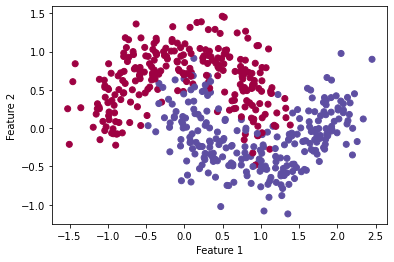

In [54]:
data_x, data_y = make_moons(500, noise=0.25, random_state=SEED)
plt.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
plt.gca().set(xlabel='Feature 1', ylabel='Feature 2')

Making my own function for one hot encoding

In [55]:

def OneHotEncoderr(labels):
    unique_labels = np.unique(labels)
    num_classes = len(unique_labels)
    label_to_one_hot = {label: np.eye(num_classes)[i] for i, label in enumerate(unique_labels)}
    one_hot_labels = np.array([label_to_one_hot[label] for label in labels])
    return one_hot_labels

Doing an 80-20 train-test split

In [57]:
X_train, X_val, Y_train, Y_val = train_test_split(data_x, data_y, test_size = 0.2, random_state=SEED)


Y_train = OneHotEncoderr(Y_train)
Y_val = OneHotEncoderr(Y_val)

print(X_train.shape)
print(X_val.shape)
print(Y_train.shape)
print(Y_val.shape)

(400, 2)
(100, 2)
(400, 2)
(100, 2)



- We plot the loss curves and also check the running time to calculate the efficiency of our model.


In [58]:
import time

def plot_losses(train_hist, val_hist):
        
    '========================'
    # Code here

    plt.figure(figsize=(10, 6))
    plt.plot(train_hist, label='Training Loss', color='blue')
    plt.plot(val_hist, label='Validation Loss', color='red')
    plt.title('Training and Validation Loss Curves')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    
    
    '========================'
    plt.show()
    

Testing our model

Layer 1 - Weight shape: (2, 60), Bias shape: (60,)
Layer 2 - Weight shape: (60, 40), Bias shape: (40,)
Layer 3 - Weight shape: (40, 20), Bias shape: (20,)
Layer 4 - Weight shape: (20, 2), Bias shape: (2,)


  0%|          | 0/500 [00:00<?, ?it/s]

Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
Delta Shape: (64, 20)

Processing Layer 3
Delta Shape: (64, 40)

Processing Layer 2
Delta Shape: (64, 60)
Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
Delta Shape: (64, 20)

Processing Layer 3
Delta Shape: (64, 40)

Processing Layer 2
Delta Shape: (64, 60)
Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
Delta Shape: (64, 20)

Processing Layer 3
Delta Shape: (64, 40)

Processing Layer 2
Delta Shape: (64, 60)
Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
Delta Shape: (64, 20)

Processing Layer 3
Delta Shape: (64, 40)

Processing Layer 2
Delta Shape: (64, 60)
Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
Delta Shape: (64, 20)

Processing Layer 3
Delta Shape: (64, 40)

Processing Layer 2
Delta Shape: (64, 60)
Output Layer Delta Shape: (64, 2)
Weight ki shape (20, 2)

Processing Layer 4
De

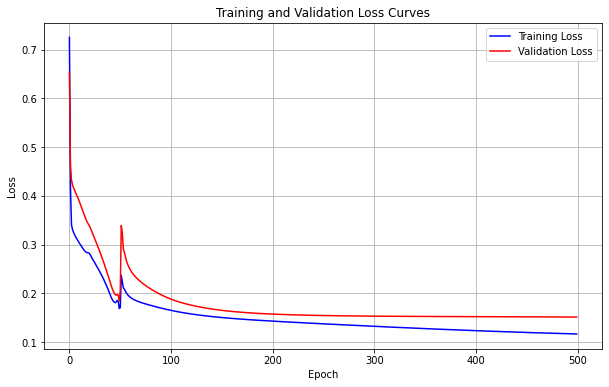

In [59]:

nn = NeuralNetwork([2, 60, 40, 20, 2], mode='classification', activation='sigmoid', optimizer = 'minibatch', batch_size=64)
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 500, lr = 0.01)

end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

plot_losses(history, val_hist)

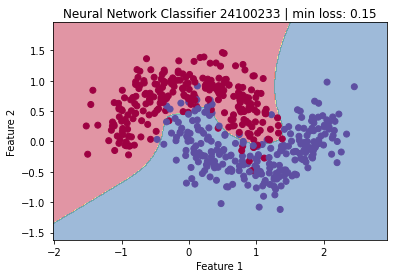

In [60]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber} | min loss: {np.min(val_hist):.2f}')
plt.show()

In [61]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.15139803119422163
Validation Accuracy: 0.93


In order to check the efficiency of my model, I use different combination of learning rates, epochs, activation functions, and optimizers to obtain the best results. I perform a total of 5 experiments. 

EXPERIMENT 1

Layer 1 - Weight shape: (2, 128), Bias shape: (128,)
Layer 2 - Weight shape: (128, 64), Bias shape: (64,)
Layer 3 - Weight shape: (64, 32), Bias shape: (32,)
Layer 4 - Weight shape: (32, 2), Bias shape: (2,)


  0%|          | 0/500 [00:00<?, ?it/s]

Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (64, 32)

Processing Layer 3
Delta Shape: (64, 64)

Processing Layer 2
Delta Shape: (64, 128)
Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (64, 32)

Processing Layer 3
Delta Shape: (64, 64)

Processing Layer 2
Delta Shape: (64, 128)
Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (64, 32)

Processing Layer 3
Delta Shape: (64, 64)

Processing Layer 2
Delta Shape: (64, 128)
Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (64, 32)

Processing Layer 3
Delta Shape: (64, 64)

Processing Layer 2
Delta Shape: (64, 128)
Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (64, 32)

Processing Layer 3
Delta Shape: (64, 64)

Processing Layer 2
Delta Shape: (64, 128)
Output Layer Delta Shape: (64, 2)
Weight ki shape (32, 2)

Processing Layer

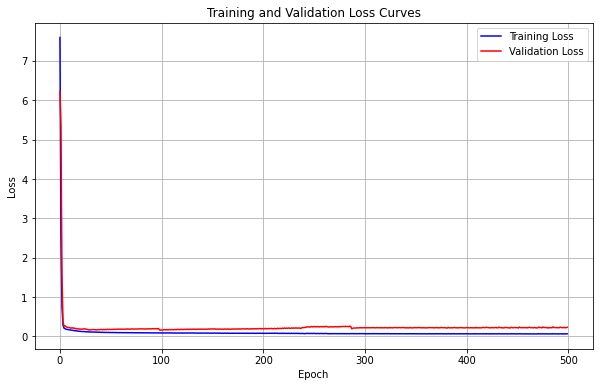

In [62]:

nn = NeuralNetwork([2, 128, 64, 32, 2], mode='classification', activation='relu', optimizer = 'minibatch', batch_size=64)  # no. of parameters = 10786
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 500, lr = 0.001)

# end time
end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

# Plot both training and val loss history
plot_losses(history, val_hist)


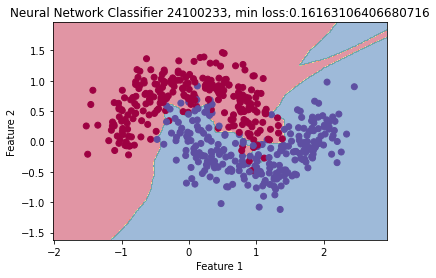

In [63]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber}, min loss:{np.min(val_hist)}')
plt.show()

In [64]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.23316556291119972
Validation Accuracy: 0.91


EXPERIMENT 2

Layer 1 - Weight shape: (2, 256), Bias shape: (256,)
Layer 2 - Weight shape: (256, 128), Bias shape: (128,)
Layer 3 - Weight shape: (128, 64), Bias shape: (64,)
Layer 4 - Weight shape: (64, 2), Bias shape: (2,)


  0%|          | 0/300 [00:00<?, ?it/s]

Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: (1, 64)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: (1, 64)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: (1, 64)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: (1, 64)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: (1, 64)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 2)
Weight ki shape (64, 2)

Processing Layer 4
Delta Shape: 

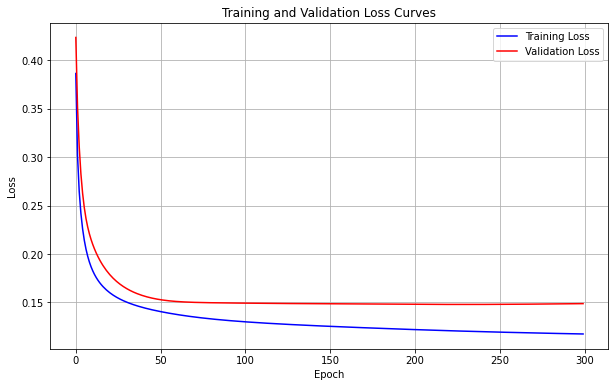

In [65]:

nn = NeuralNetwork( [2, 256, 128, 64, 2], mode='classification', activation='sigmoid', optimizer = 'sgd', batch_size=64)   # no. of parameters = 42050
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 300, lr = 0.001)

# end time
end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

# Plot both training and val loss history
plot_losses(history, val_hist)


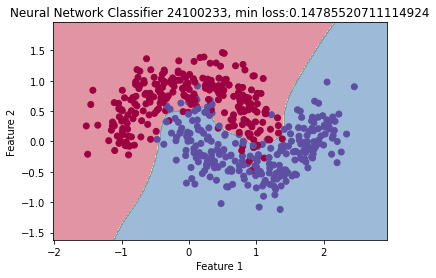

In [66]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber}, min loss:{np.min(val_hist)}')
plt.show()

In [67]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.14869443846304467
Validation Accuracy: 0.92


EXPERIMENT 3

Layer 1 - Weight shape: (2, 500), Bias shape: (500,)
Layer 2 - Weight shape: (500, 500), Bias shape: (500,)
Layer 3 - Weight shape: (500, 500), Bias shape: (500,)
Layer 4 - Weight shape: (500, 500), Bias shape: (500,)
Layer 5 - Weight shape: (500, 2), Bias shape: (2,)


  0%|          | 0/600 [00:00<?, ?it/s]

Output Layer Delta Shape: (64, 2)
Weight ki shape (500, 2)

Processing Layer 5
Delta Shape: (64, 500)

Processing Layer 4
Delta Shape: (64, 500)

Processing Layer 3
Delta Shape: (64, 500)

Processing Layer 2
Delta Shape: (64, 500)
Output Layer Delta Shape: (64, 2)
Weight ki shape (500, 2)

Processing Layer 5
Delta Shape: (64, 500)

Processing Layer 4
Delta Shape: (64, 500)

Processing Layer 3
Delta Shape: (64, 500)

Processing Layer 2
Delta Shape: (64, 500)
Output Layer Delta Shape: (64, 2)
Weight ki shape (500, 2)

Processing Layer 5
Delta Shape: (64, 500)

Processing Layer 4
Delta Shape: (64, 500)

Processing Layer 3
Delta Shape: (64, 500)

Processing Layer 2
Delta Shape: (64, 500)
Output Layer Delta Shape: (64, 2)
Weight ki shape (500, 2)

Processing Layer 5
Delta Shape: (64, 500)

Processing Layer 4
Delta Shape: (64, 500)

Processing Layer 3
Delta Shape: (64, 500)

Processing Layer 2
Delta Shape: (64, 500)
Output Layer Delta Shape: (64, 2)
Weight ki shape (500, 2)

Processing Layer

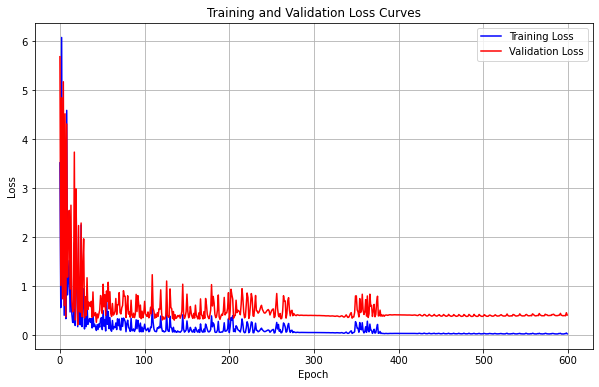

In [68]:
nn = NeuralNetwork([2, 500,500 , 500,500, 2], mode='classification', activation='sigmoid', optimizer = 'minibatch', batch_size=64)    # no. of parameters = 754002
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 600, lr = 0.0050)

# end time
end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

# Plot both training and val loss history
plot_losses(history, val_hist)


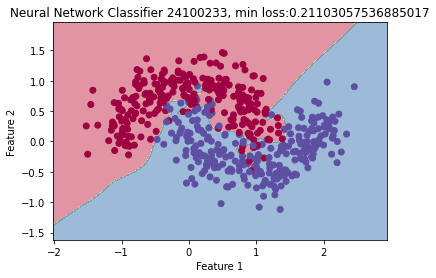

In [69]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber}, min loss:{np.min(val_hist)}')
plt.show()

In [70]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.4088340063064298
Validation Accuracy: 0.89


EXPERIMENT 4

Layer 1 - Weight shape: (2, 1000), Bias shape: (1000,)
Layer 2 - Weight shape: (1000, 500), Bias shape: (500,)
Layer 3 - Weight shape: (500, 2), Bias shape: (2,)


  0%|          | 0/650 [00:00<?, ?it/s]

Output Layer Delta Shape: (400, 2)
Weight ki shape (500, 2)

Processing Layer 3
Delta Shape: (400, 500)

Processing Layer 2
Delta Shape: (400, 1000)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (500, 2)

Processing Layer 3
Delta Shape: (400, 500)

Processing Layer 2
Delta Shape: (400, 1000)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (500, 2)

Processing Layer 3
Delta Shape: (400, 500)

Processing Layer 2
Delta Shape: (400, 1000)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (500, 2)

Processing Layer 3
Delta Shape: (400, 500)

Processing Layer 2
Delta Shape: (400, 1000)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
W

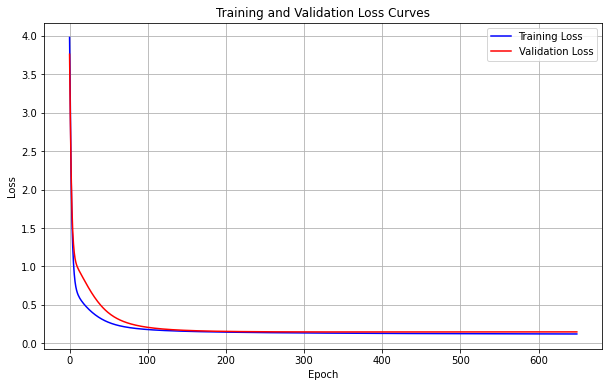

In [71]:

nn = NeuralNetwork( [2, 1000 ,500,2], mode='classification', activation='sigmoid', optimizer = 'fullbatch', batch_size=64)   # no. of parameters = 504502
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 650, lr = 0.000010)

# end time
end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

# Plot both training and val loss history
plot_losses(history, val_hist)


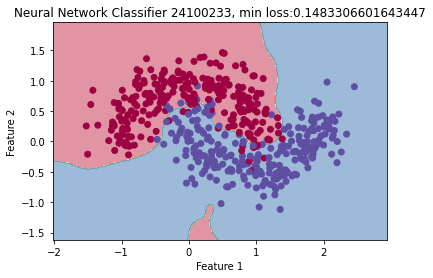

In [72]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber}, min loss:{np.min(val_hist)}')
plt.show()

In [73]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.14923948962311126
Validation Accuracy: 0.93


EXPERIMENT 5

Layer 1 - Weight shape: (2, 28), Bias shape: (28,)
Layer 2 - Weight shape: (28, 64), Bias shape: (64,)
Layer 3 - Weight shape: (64, 32), Bias shape: (32,)
Layer 4 - Weight shape: (32, 2), Bias shape: (2,)


  0%|          | 0/1500 [00:00<?, ?it/s]

Output Layer Delta Shape: (400, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (400, 32)

Processing Layer 3
Delta Shape: (400, 64)

Processing Layer 2
Delta Shape: (400, 28)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (400, 32)

Processing Layer 3
Delta Shape: (400, 64)

Processing Layer 2
Delta Shape: (400, 28)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (400, 32)

Processing Layer 3
Delta Shape: (400, 64)

Processing Layer 2
Delta Shape: (400, 28)
y_pred shape: (400, 2)
y_true shape: (400, 2)
y_pred shape: (100, 2)
y_true shape: (100, 2)
Output Layer Delta Shape: (400, 2)
Weight ki shape (32, 2)

Processing Layer 4
Delta Shape: (400, 32)

Processing Layer 3
Delta Shape: (400, 64)

Processing Lay

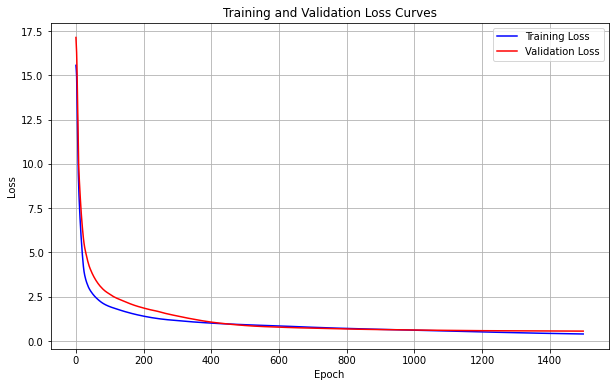

In [74]:

nn = NeuralNetwork([2, 28,64,32, 2], mode='classification', activation='relu', optimizer = 'fullbatch', batch_size=64)    # no. of parameters = 4086
start = time.time()
history, val_hist = nn.fit(X_train, Y_train, X_val, Y_val, epochs = 1500, lr = 0.000001)

# end time
end = time.time()
print("Runtime of the algorithm is ",round((end - start),3)," seconds")

# Plot both training and val loss history
plot_losses(history, val_hist)


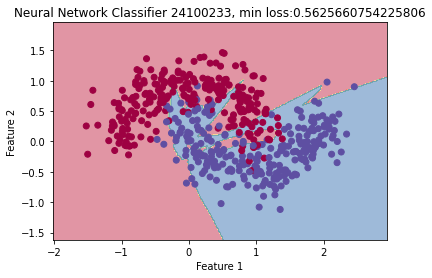

In [75]:
fig, ax = plt.subplots()
x_min, x_max = data_x[:, 0].min() - .5, data_x[:, 0].max() + .5
y_min, y_max = data_x[:, 1].min() - .5, data_x[:, 1].max() + .5
plot_decision_boundary(lambda x: nn.predict(x).argmax(axis=1), 
                       x_min, x_max, y_min, y_max, 
                       plt.cm.Spectral, ax)
ax.scatter(data_x[:,0], data_x[:,1], c=data_y, cmap=plt.cm.Spectral)
ax.set(xlabel='Feature 1', ylabel='Feature 2', title=f'Neural Network Classifier {rollnumber}, min loss:{np.min(val_hist)}')
plt.show()

In [76]:
test_loss, test_accuracy = nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {test_loss}")
print(f"Validation Accuracy: {test_accuracy}")

y_pred shape: (100, 2)
y_true shape: (100, 2)
y_pred shape: (100,)
y_true shape: (100,)
Validation Loss: 0.5626284753607041
Validation Accuracy: 0.87


                                                                Final Comment for Task 2


Experiment 4, with 2 hidden layers with 1000 nodes in first hidden layer and 500 nodes in second hidden layer alongwith a combination of activation function 'sigmoid' and optimizer 'fullbatch' turned out to be the best result producing combination. I obtained an accuracy of 0.93. I also used learning rate of 0.000010 and 650 epochs

# Regression

Let's use the model we just created for a regression task. To make things interesting, we'll sample from a rather ugly regression equation:

$y = 2 X_1^5 + 4 X_2^2 - X_1 X_2 + 10 X_2 \cdot (\sin(X_1)^{13.5}) + 3 X_2 + 5 + \epsilon$

where $\epsilon$ represents the noise added to the data


In [77]:
import numpy as np
import matplotlib.pyplot as plt
np.random.seed(8)

# Generate random data with two features (X1, X2)
num_samples = 500
X1 = 2 * np.random.rand(num_samples, 1)
X2 = 3 * np.random.rand(num_samples, 1)
noise = 2 * np.random.randn(num_samples, 1)

X = np.hstack((X1, X2))

# Regression equation
y = 2 * X1**5 + 4 * X2**2 - X1*X2 + 10*X2*(np.sin(X1)**13.5) + 3 * X2 + 5 + noise


Let's see if our neural network can learn to predict the y values given the features (Xs). 
First, split `X` and `y` into training and validation cohorts. 

In [79]:
X_train, X_val, Y_train, Y_val = train_test_split(X, y,test_size=0.2,random_state=42) 

Let's experiment our neural network in regression mode with different combination of epochs, learning rates, activation functions, and optimizers.

EXPERIMENT 1

In [80]:

regression_nn = NeuralNetwork(nodes_per_layer=[2, 100, 90,50, 1], mode='regression', optimizer='minibatch', activation='sigmoid', batch_size=64)

X_train, X_val, Y_train, Y_val = train_test_split(X, y, test_size=0.2, random_state=42)

epochs = 1000
learning_rate = 0.0001
regression_nn.fit(X_train, Y_train, X_val, Y_val, epochs, lr=learning_rate)

validation_loss = regression_nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {validation_loss}")


Layer 1 - Weight shape: (2, 100), Bias shape: (100,)
Layer 2 - Weight shape: (100, 90), Bias shape: (90,)
Layer 3 - Weight shape: (90, 50), Bias shape: (50,)
Layer 4 - Weight shape: (50, 1), Bias shape: (1,)


  0%|          | 0/1000 [00:00<?, ?it/s]

Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer 4
Delta Shape: (64, 50)

Processing Layer 3
Delta Shape: (64, 90)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer 4
Delta Shape: (64, 50)

Processing Layer 3
Delta Shape: (64, 90)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer 4
Delta Shape: (64, 50)

Processing Layer 3
Delta Shape: (64, 90)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer 4
Delta Shape: (64, 50)

Processing Layer 3
Delta Shape: (64, 90)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer 4
Delta Shape: (64, 50)

Processing Layer 3
Delta Shape: (64, 90)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (50, 1)

Processing Layer

Let's see how well the model's predictions match to the ground truth values.

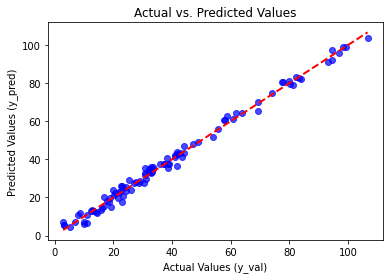

In [81]:
y_pred = regression_nn.predict(X_val)
plt.scatter(Y_val, y_pred, c='blue', alpha=0.7)
plt.plot([min(Y_val), max(Y_val)], [min(Y_val), max(Y_val)], '--', color='red', linewidth=2)  # Diagonal line for reference
plt.xlabel('Actual Values (y_val)')
plt.ylabel('Predicted Values (y_pred)')
plt.title('Actual vs. Predicted Values')
plt.show()

EXPERIMENT 2

In [82]:

regression_nn = NeuralNetwork(nodes_per_layer=[2, 100,50,10, 1], mode='regression', optimizer='minibatch', activation='relu', batch_size=64)

X_train, X_val, Y_train, Y_val = train_test_split(X, y, test_size=0.2, random_state=42)

epochs = 1000
learning_rate = 0.00000015
regression_nn.fit(X_train, Y_train, X_val, Y_val, epochs, lr=learning_rate)

validation_loss = regression_nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {validation_loss}")


Layer 1 - Weight shape: (2, 100), Bias shape: (100,)
Layer 2 - Weight shape: (100, 50), Bias shape: (50,)
Layer 3 - Weight shape: (50, 10), Bias shape: (10,)
Layer 4 - Weight shape: (10, 1), Bias shape: (1,)


  0%|          | 0/1000 [00:00<?, ?it/s]

Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer 4
Delta Shape: (64, 10)

Processing Layer 3
Delta Shape: (64, 50)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer 4
Delta Shape: (64, 10)

Processing Layer 3
Delta Shape: (64, 50)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer 4
Delta Shape: (64, 10)

Processing Layer 3
Delta Shape: (64, 50)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer 4
Delta Shape: (64, 10)

Processing Layer 3
Delta Shape: (64, 50)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer 4
Delta Shape: (64, 10)

Processing Layer 3
Delta Shape: (64, 50)

Processing Layer 2
Delta Shape: (64, 100)
Output Layer Delta Shape: (64, 1)
Weight ki shape (10, 1)

Processing Layer

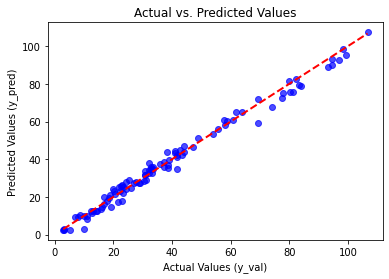

In [83]:
y_pred = regression_nn.predict(X_val)
plt.scatter(Y_val, y_pred, c='blue', alpha=0.7)
plt.plot([min(Y_val), max(Y_val)], [min(Y_val), max(Y_val)], '--', color='red', linewidth=2)  # Diagonal line for reference
plt.xlabel('Actual Values (y_val)')
plt.ylabel('Predicted Values (y_pred)')
plt.title('Actual vs. Predicted Values')
plt.show()

EXPERIMENT 3

In [84]:

regression_nn = NeuralNetwork(nodes_per_layer=[2,256,128,54,1], mode='regression', optimizer='sgd', activation='sigmoid', batch_size=64)

X_train, X_val, Y_train, Y_val = train_test_split(X, y, test_size=0.2, random_state=42)

epochs = 100
learning_rate = 0.0005
regression_nn.fit(X_train, Y_train, X_val, Y_val, epochs, lr=learning_rate)

validation_loss = regression_nn.evaluate(X_val, Y_val)
print(f"Validation Loss: {validation_loss}")


Layer 1 - Weight shape: (2, 256), Bias shape: (256,)
Layer 2 - Weight shape: (256, 128), Bias shape: (128,)
Layer 3 - Weight shape: (128, 54), Bias shape: (54,)
Layer 4 - Weight shape: (54, 1), Bias shape: (1,)


  0%|          | 0/100 [00:00<?, ?it/s]

Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: (1, 54)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: (1, 54)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: (1, 54)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: (1, 54)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: (1, 54)

Processing Layer 3
Delta Shape: (1, 128)

Processing Layer 2
Delta Shape: (1, 256)
Output Layer Delta Shape: (1, 1)
Weight ki shape (54, 1)

Processing Layer 4
Delta Shape: 

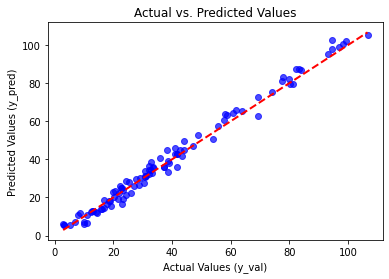

In [85]:
y_pred = regression_nn.predict(X_val)
plt.scatter(Y_val, y_pred, c='blue', alpha=0.7)
plt.plot([min(Y_val), max(Y_val)], [min(Y_val), max(Y_val)], '--', color='red', linewidth=2)  # Diagonal line for reference
plt.xlabel('Actual Values (y_val)')
plt.ylabel('Predicted Values (y_pred)')
plt.title('Actual vs. Predicted Values')
plt.show()

# Trying the model on real data.

Alright, enough playing with dummy data. Let's test our model on a real-world dataset. For this task, we will be using the `breast-cancer.csv` file (downloaded from Kaggle), and will be classifying Breast Cancer diagnosis as either Malignant or Benign. 

In [86]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder


df = pd.read_csv('breast-cancer.csv')

X = df.drop('diagnosis', axis=1).values
y = df['diagnosis'].values

# Doing train-test split and declaring our model.

In [87]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

num_classes = len(np.unique(y_encoded))
y_train_onehot = np.eye(num_classes)[y_train].astype(int)
y_test_onehot = np.eye(num_classes)[y_test].astype(int)

model = NeuralNetwork(nodes_per_layer=[X.shape[1], 20, 20, num_classes], mode='classification', optimizer='fullbatch', activation='sigmoid', batch_size=64)



Layer 1 - Weight shape: (31, 20), Bias shape: (20,)
Layer 2 - Weight shape: (20, 20), Bias shape: (20,)
Layer 3 - Weight shape: (20, 2), Bias shape: (2,)


Model evaluation

In [88]:

epochs = 1000
learning_rate = 0.0001
history, val_history = model.fit(X_train, y_train_onehot, X_test, y_test_onehot, epochs, lr=learning_rate)

test_loss, test_accuracy = model.evaluate(X_test, y_test_onehot)
print(f"\nTest Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

  0%|          | 0/1000 [00:00<?, ?it/s]

Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (

C:\Users\HP\AppData\Local\Temp\ipykernel_11600\2584781315.py:42: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (20, 2)

Processing Layer 3
Delta Shape: (455, 20)

Processing Layer 2
Delta Shape: (455, 20)
y_pred shape: (455, 2)
y_true shape: (455, 2)
y_pred shape: (114, 2)
y_true shape: (114, 2)
Output Layer Delta Shape: (455, 2)
Weight ki shape (

We obtained an accuracy of 0.66 for our dataset. A better combination of optimizers, activation functions, learning rate and epochs can help in maximizing the results. <br>
Users are welcome to use any dataset for both regression or classification.